In [15]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import random
import cv2
from PIL import Image
from sklearn.model_selection import train_test_split
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.layers import Flatten , Dense
from tensorflow.keras.models import Model

<b>Load Dataset

In [3]:
# Load the Training Dataset
train_dataset_path = "E:/software/Test Task/Ass 1/assignment3/train_labels.csv"
train_dataset = pd.read_csv(train_dataset_path)

# Display the Data of the Dataset
train_dataset.head()

,filename,width,height,class,xmin,ymin,xmax,ymax
0,Data-Images/Cars/105.jpg,684,293,license_plate,12,106,696,399
1,Data-Images/Cars/38.jpg,118,39,license_plate,794,485,912,524
2,Data-Images/Cars/136.jpg,173,74,license_plate,155,200,328,274
3,Data-Images/Cars/127.jpg,416,154,license_plate,191,54,607,208
4,Data-Images/Cars/21.jpg,238,63,license_plate,272,2,510,65


In [4]:
# Define the List for Images and Targets
images  = []
targets = []

# Define the Path of the Images
base_path_images = "E:/software/Test Task/Ass 1/assignment3"

count = 0
# Extract the Images by Iterating
for filename in train_dataset["filename"]:
    # Extract the Image Path
    image_path = os.path.join(base_path_images, filename)
    
    # Read the Image
    image = Image.open(image_path)
    
    # Extract the Image Width and Height
    w , h = image.size

    # Get the X,Y,Widt,Height
    x = float(train_dataset["xmin"][count]) / w
    y = float(train_dataset["ymin"][count]) / h
    width  = float(train_dataset["xmax"][count]) / w
    height = float(train_dataset["ymax"][count]) / h
    
    # Reshape the Image
    reshape_image = image.resize((224,224))
    
    # Append the Images and Targets
    images.append(np.array(reshape_image))
    targets.append((x,y,width,height))
    
    count += 1

In [5]:
# Display the Shape of the Images and targets
print(f"Shape of the Images is : {np.shape(images)}")
print(f"Shape of the Target is : {np.shape(targets)}")

Shape of the Images is : (225, 224, 224, 3)
Shape of the Target is : (225, 4)


<b>Convert the Images and Targets in the Numpy Array

In [8]:
# Convert the images and targets in the Numpy Matrix
Images = np.array(images , dtype = "float32") / 255.0
Targets = np.array(targets , dtype = "float32")

<b>Splitting Images and Targets in the Training and Testing Dataset

In [11]:
# Split the Dataset into Training and Testing
x_train , x_val , y_train , y_val = train_test_split(Images , Targets , test_size = 0.1 , random_state = 42)

# Display the Shapes
print(f"Shape of X Train is : {x_train.shape}")
print(f"Shape of Y Train is : {y_train.shape}")
print(f"Shape of X Val   is : {x_val.shape}")
print(f"Shape of Y Val   is : {y_val.shape}")

Shape of X Train is : (202, 224, 224, 3)
Shape of Y Train is : (202, 4)
Shape of X Val   is : (23, 224, 224, 3)
Shape of Y Val   is : (23, 4)


<b>Load the VGG16 PRe-Trained Model

In [13]:
# Create the Object of VGG16 Pre-Trained Model
modelVGG16 = VGG16(weights = "imagenet" , include_top = False , input_shape = (224,224,3))

# Display the Summary of the VGG16 Model
modelVGG16.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [16]:
# Freeze the Trainable Layers of VGG16
modelVGG16.trainable = False

# Now Flatten The VGG16 Model Outpust
flatten = Flatten()(modelVGG16.output)

# Now Applying the Fully Connected Layers
x = Dense(256 , activation = "relu")(flatten)
x = Dense(128 , activation = "relu")(x)
x = Dense(64  , activation = "relu")(x)
x = Dense(32  , activation = "relu")(x)
bbox = Dense(4)(x)

# Create the FinalModels 
finalModel = Model(inputs = modelVGG16.input , outputs = bbox)

# Now Compile the Final Model
finalModel.compile(loss = "mse" , optimizer = "adam")

# Now Display the Summary of the Final Model
finalModel.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

<b>Train the Model in the Training Dataset

In [29]:
modelHistory = finalModel.fit(x_train , y_train , validation_data = (x_val , y_val) , batch_size = 32 , verbose = 1 , epochs = 50)

Epoch 1/50
7/7 [==============================] - 91s 13s/step - loss: 0.0495 - val_loss: 0.0249
Epoch 2/50
7/7 [==============================] - 90s 13s/step - loss: 0.0372 - val_loss: 0.0529
Epoch 3/50
7/7 [==============================] - 85s 12s/step - loss: 0.0346 - val_loss: 0.0364
Epoch 4/50
7/7 [==============================] - 84s 12s/step - loss: 0.0254 - val_loss: 0.0253
Epoch 5/50
7/7 [==============================] - 83s 12s/step - loss: 0.0179 - val_loss: 0.0169
Epoch 6/50
7/7 [==============================] - 81s 12s/step - loss: 0.0116 - val_loss: 0.0216
Epoch 7/50
7/7 [==============================] - 82s 12s/step - loss: 0.0107 - val_loss: 0.0157
Epoch 8/50
7/7 [==============================] - 81s 12s/step - loss: 0.0139 - val_loss: 0.0202
Epoch 9/50
7/7 [==============================] - 81s 12s/step - loss: 0.0195 - val_loss: 0.0449
Epoch 10/50
7/7 [==============================] - 82s 12s/step - loss: 0.0215 - val_loss: 0.0206
Epoch 11/50
7/7 [============

<b>Predict the Results in Testing Dataset

In [30]:
# Define the Testing Dataset
test_dataset_path = "E:/software/Test Task/Ass 1/assignment3/test_labels.csv"

# Read the Test CSV File
test_dataset = pd.read_csv(test_dataset_path)

1/1 [==============================] - 0s 350ms/step


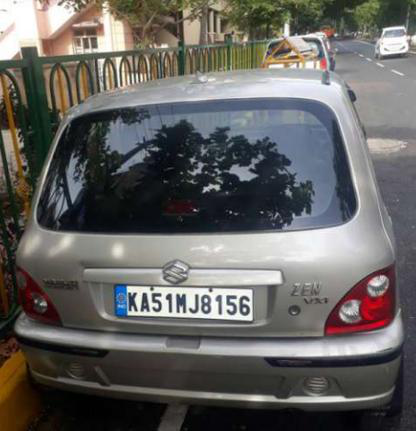

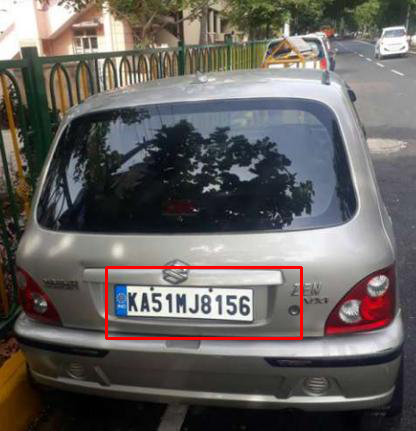

1/1 [==============================] - 0s 377ms/step


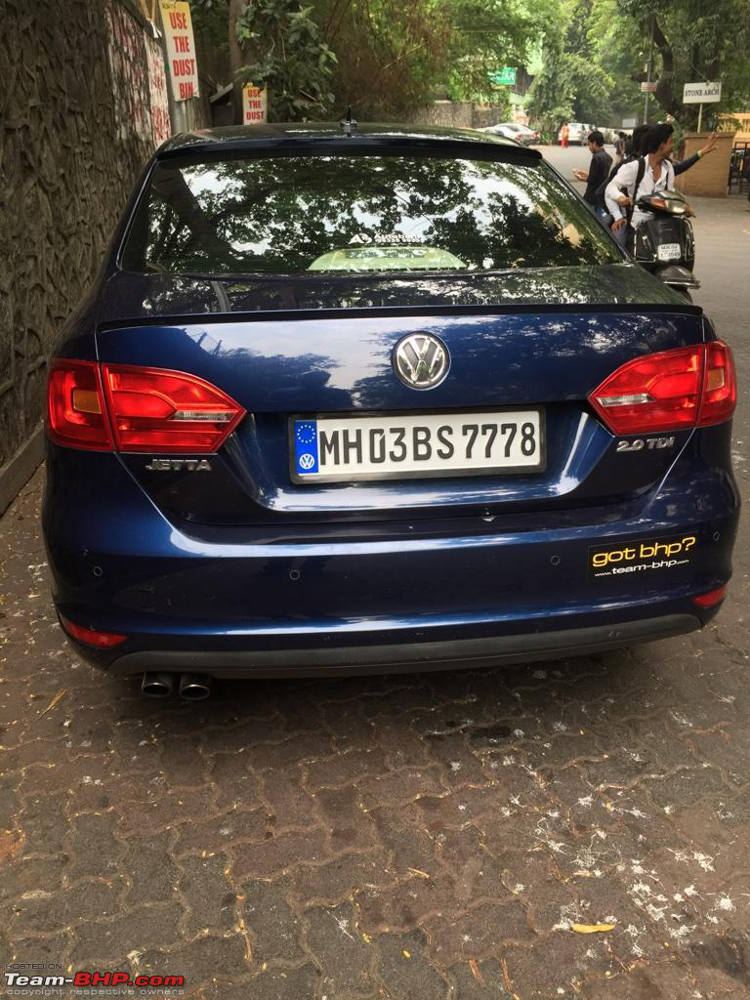

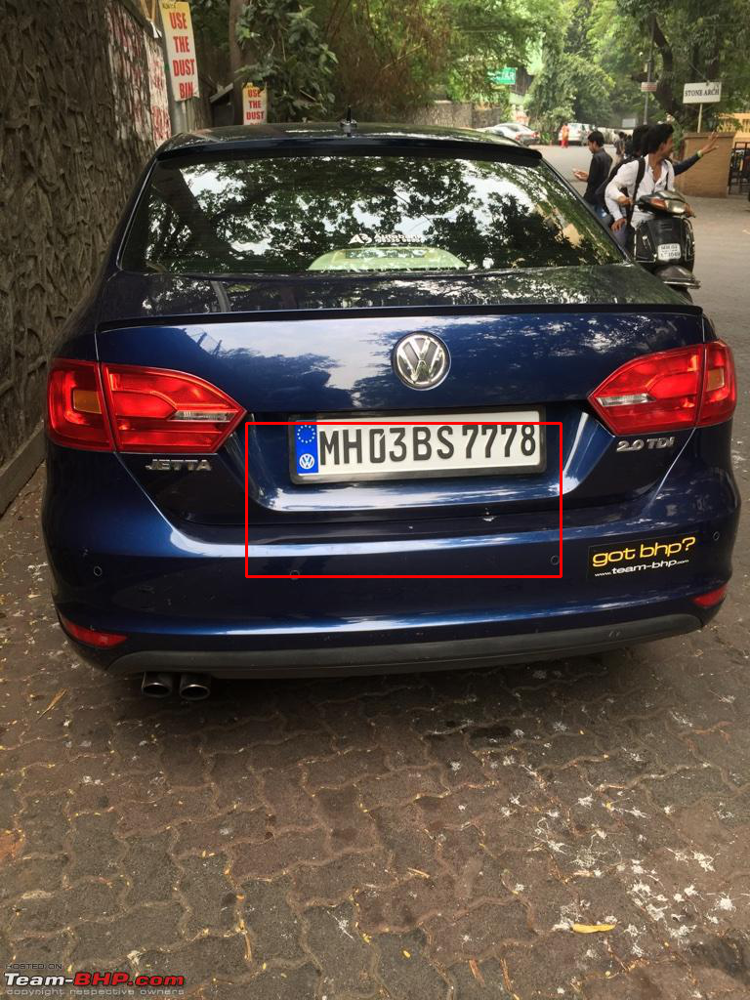

1/1 [==============================] - 0s 377ms/step


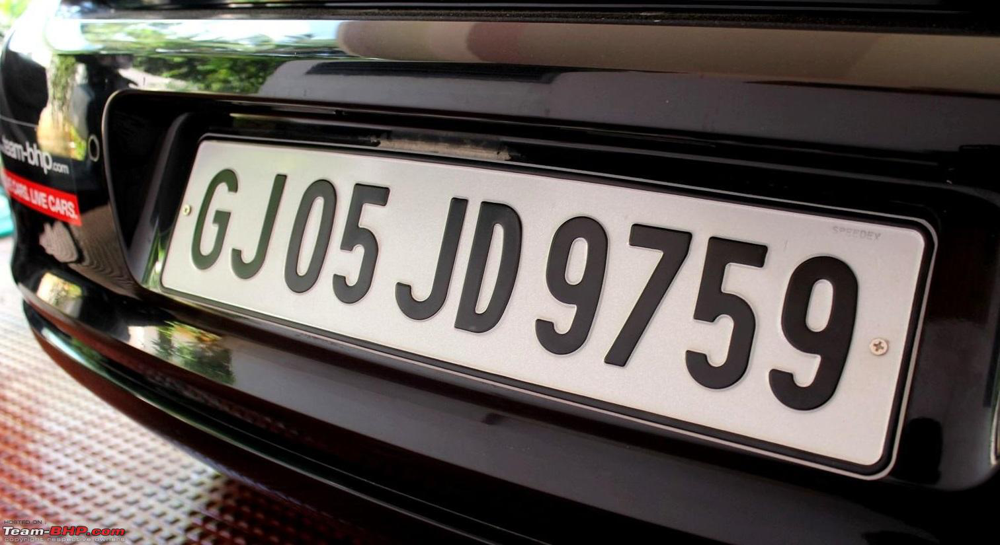

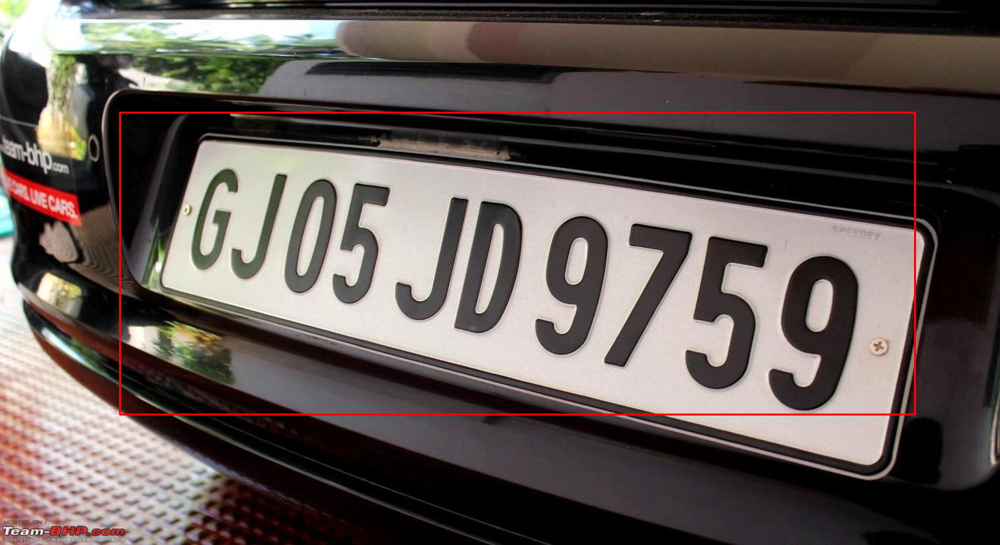

1/1 [==============================] - 0s 399ms/step


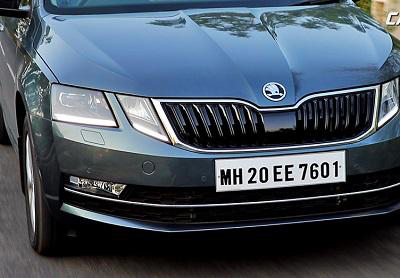

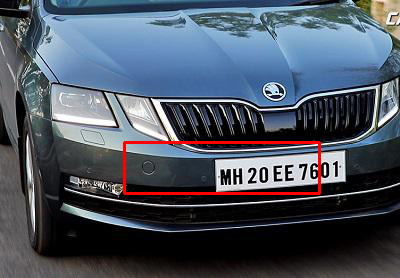

1/1 [==============================] - 0s 385ms/step


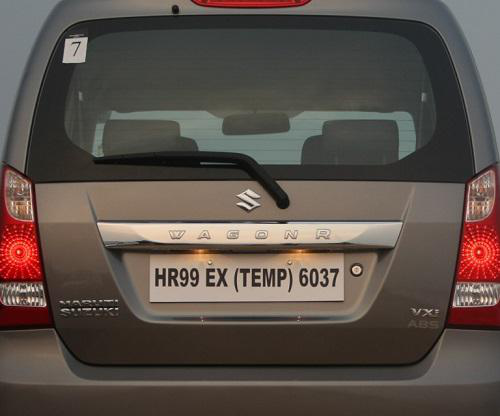

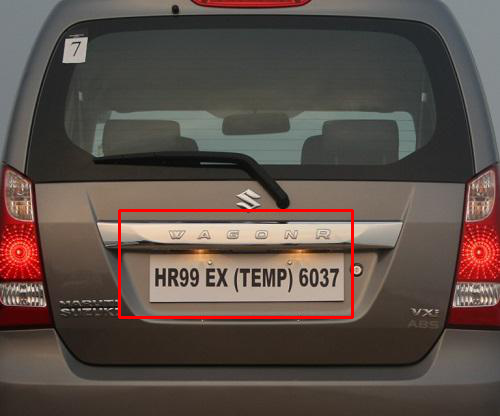

1/1 [==============================] - 0s 382ms/step


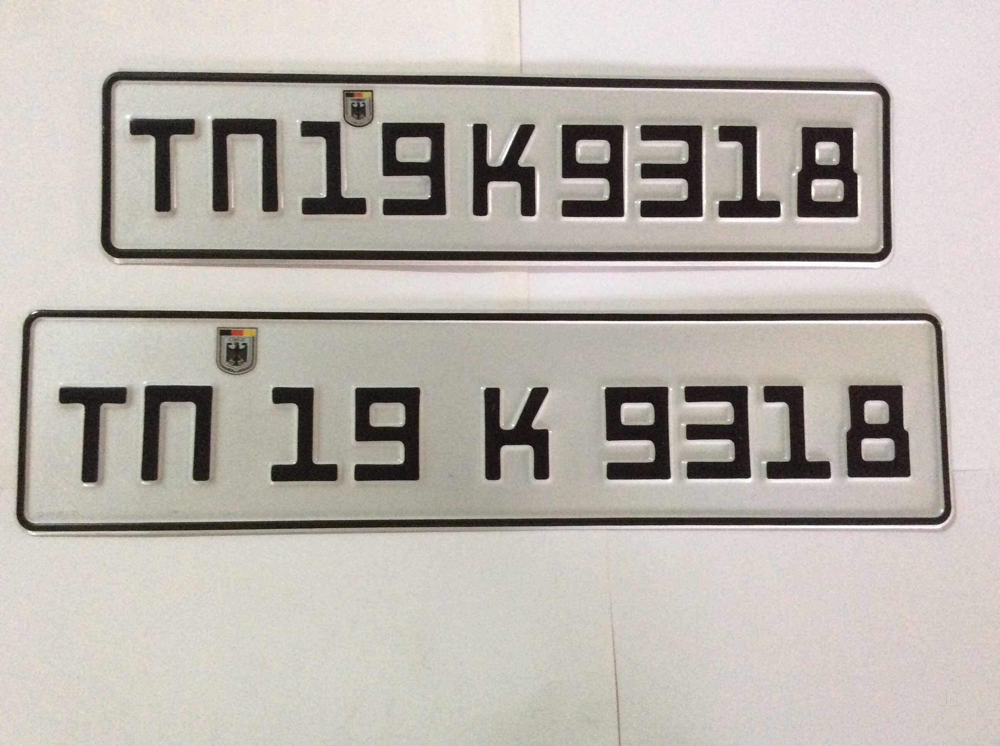

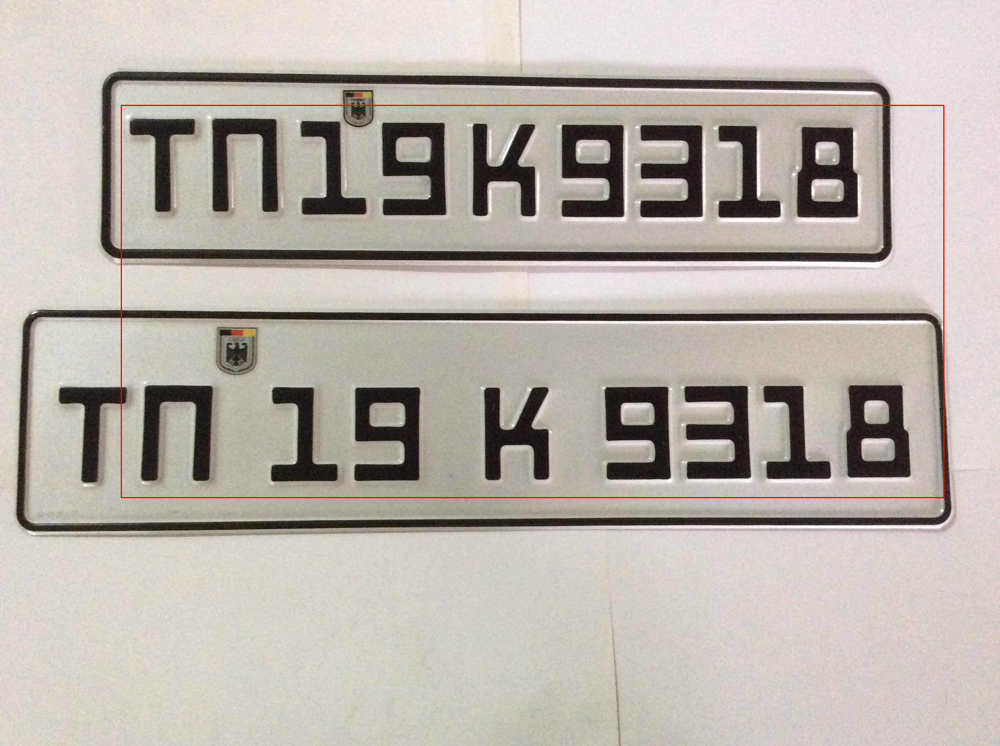

1/1 [==============================] - 0s 495ms/step


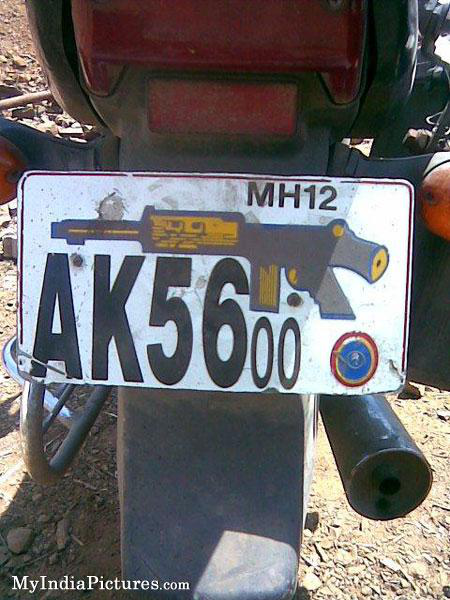

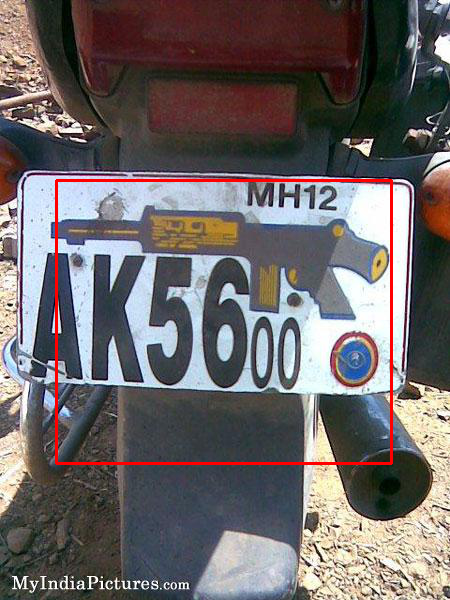

1/1 [==============================] - 0s 434ms/step


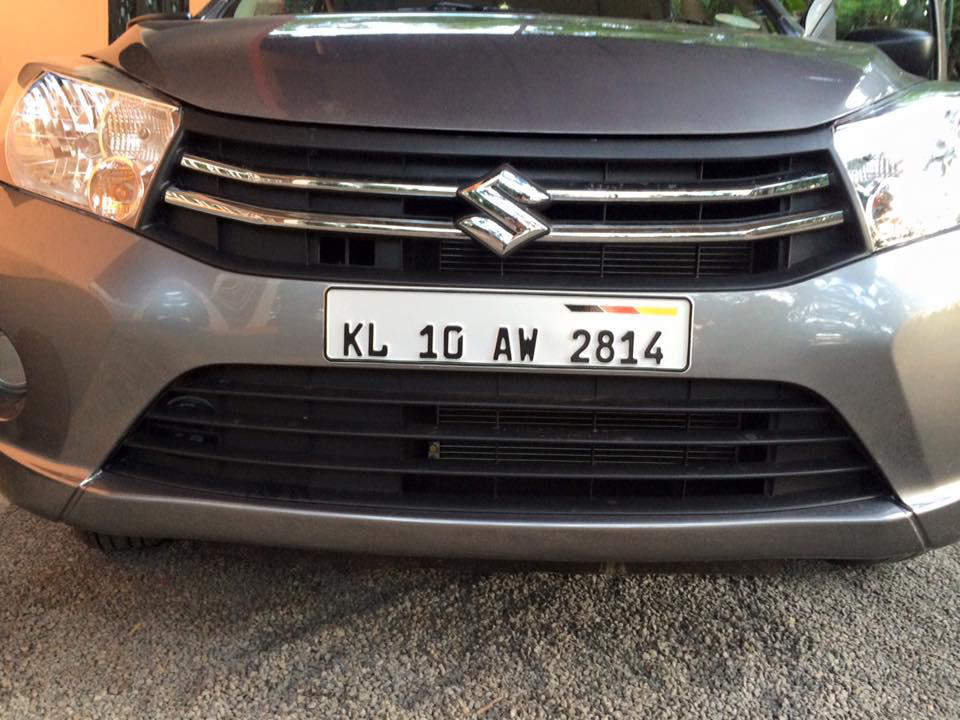

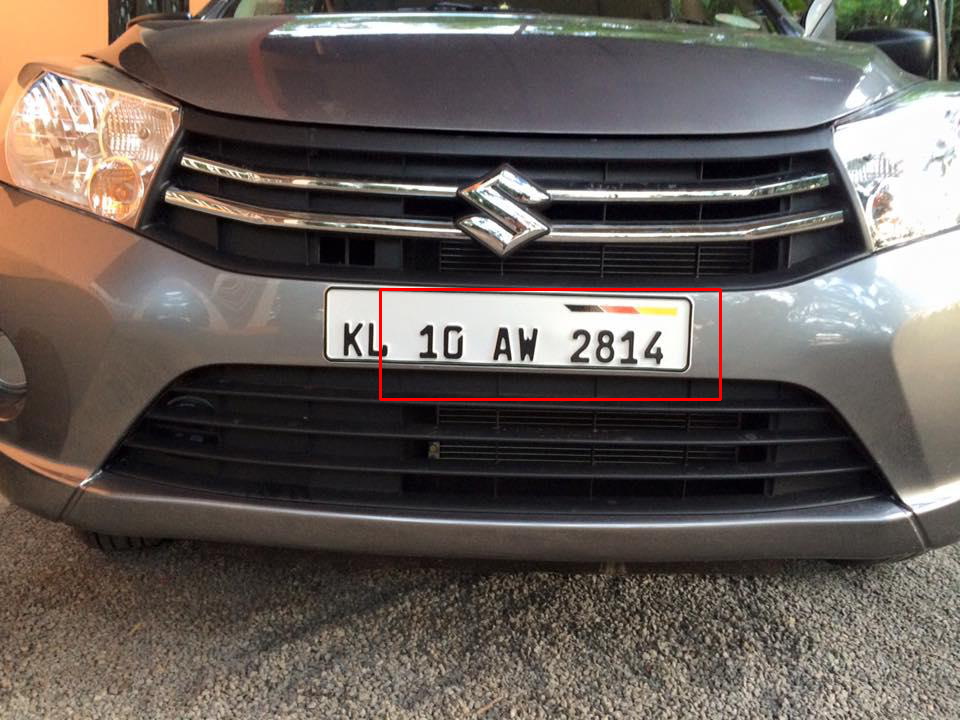

1/1 [==============================] - 0s 446ms/step


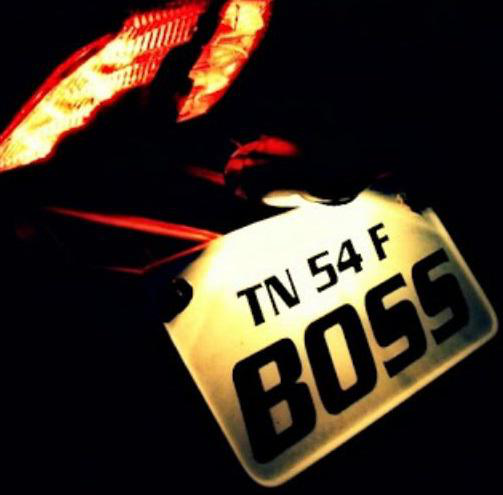

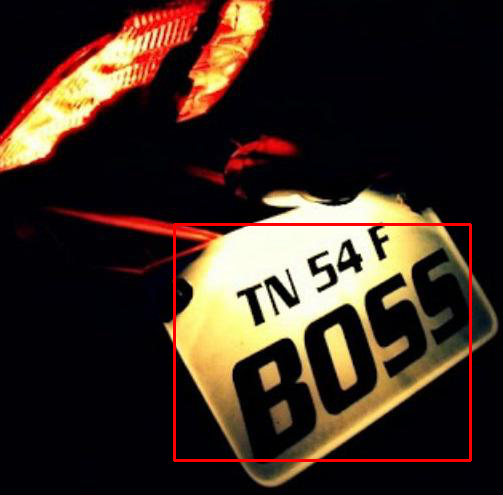

1/1 [==============================] - 0s 456ms/step


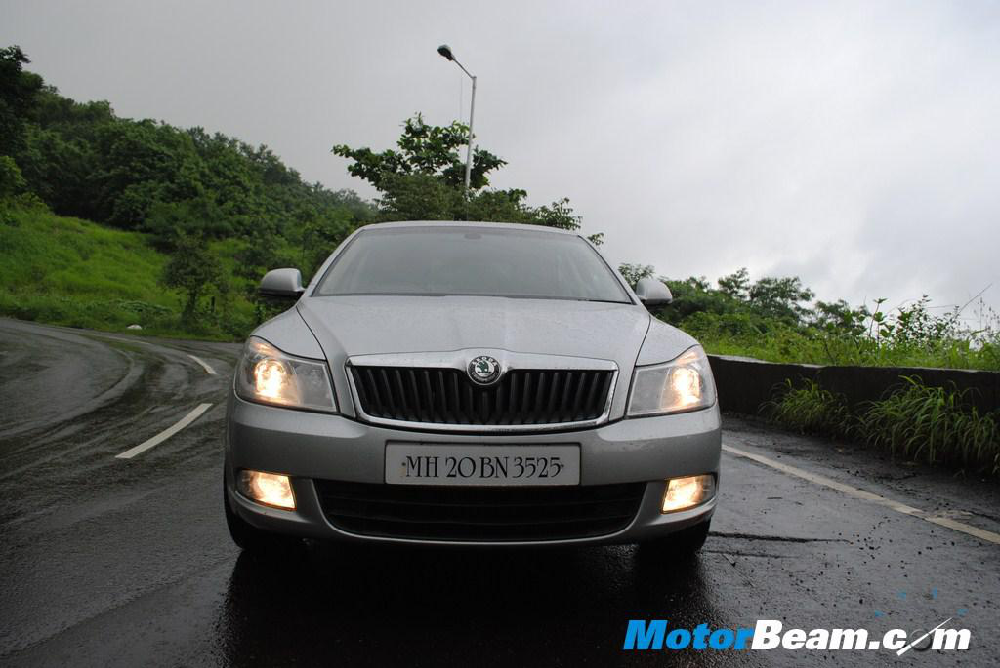

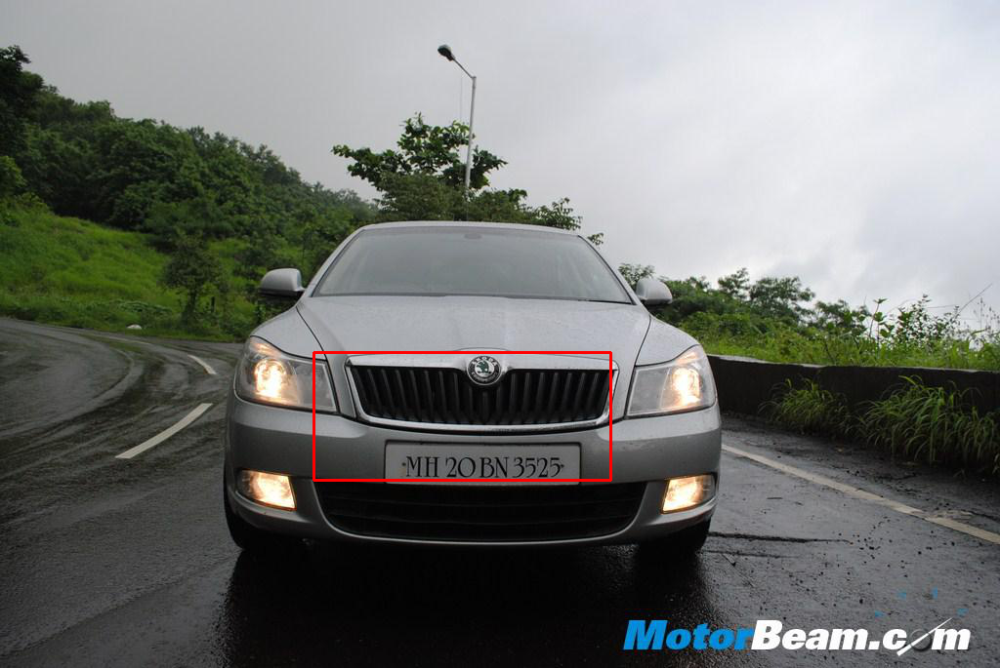

1/1 [==============================] - 0s 493ms/step


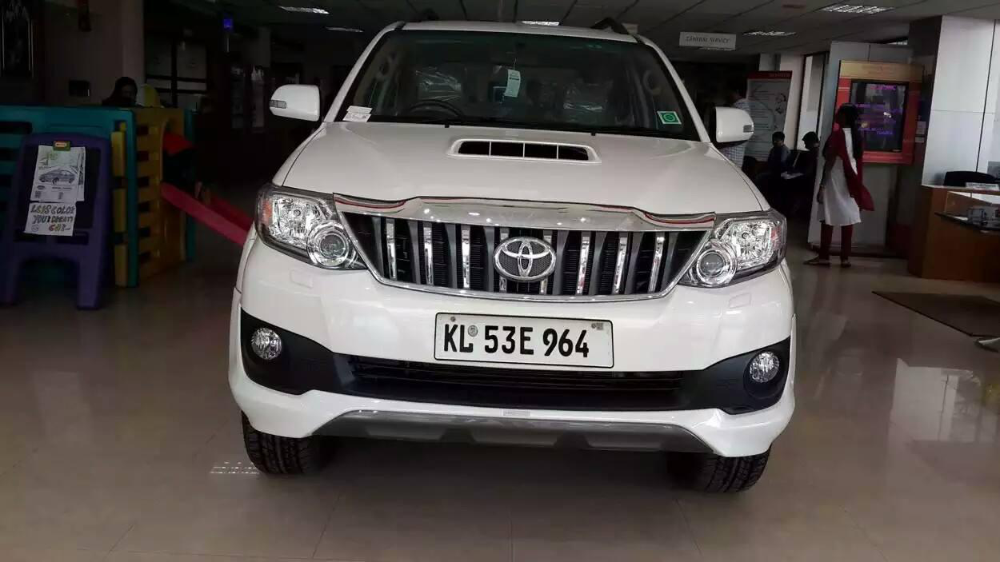

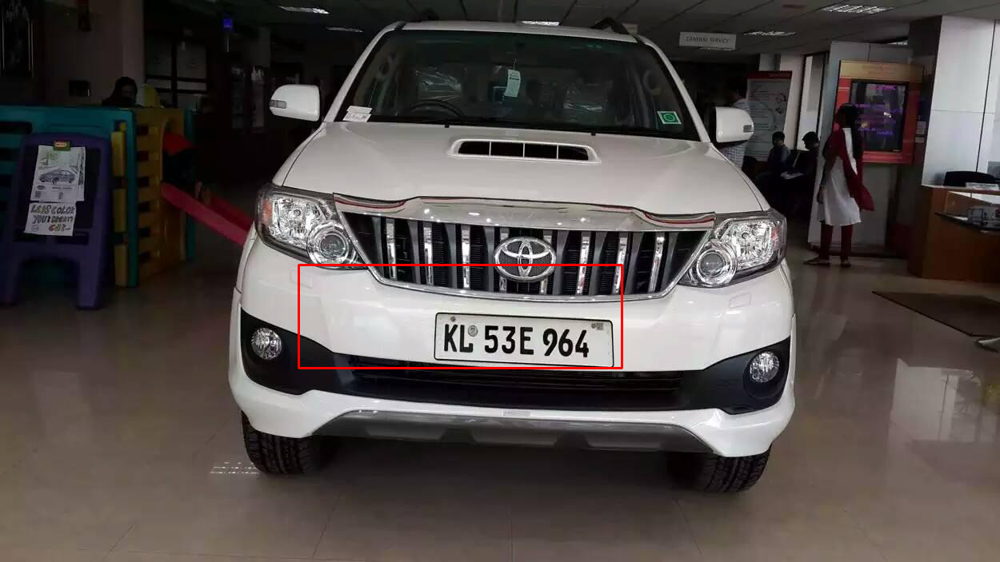

1/1 [==============================] - 0s 448ms/step


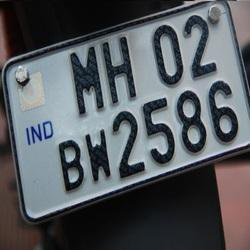

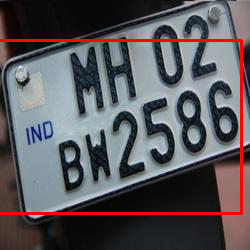

In [31]:
# Now get the Images 
for filename in test_dataset["filename"]:
    # Get the Image Path 
    image_path = os.path.join(base_path_images, filename)
    
    # Read the Image
    image = Image.open(image_path)
    
    # Extract the Size of Image
    w,h = image.size
    
    # Resize the Image
    resize_image = image.resize((224,224))
    
    # Convert the Numpy Array Image
    cv2_image = np.array(resize_image)
    
    # Rescale the Image
    cv2_image = cv2_image / 255.0
    
    # Predict the Image
    finalImage = np.expand_dims(cv2_image,axis=0)
    prediction = finalModel.predict(finalImage)[0]
    
    # Now get the X,Y,Width and Height
    x = int(prediction[0] * w)
    y = int(prediction[1] * h)
    width = int(prediction[2] * w)
    height = int(prediction[3] * h)
    
    # Again Create Numpy Array
    cv2_image_2 = np.array(image)
    cv2.rectangle(cv2_image_2 , (x,y) , (width , height) , (255,0,0) , 2)
    
    # Display the Image
    display(image)
    display(Image.fromarray(cv2_image_2))